# Using Remote Sensing data and NDVI to identify locations of air quality measurements in Potsdam 

**Germany**

# Abstract:

`Spatio-temporal` and analyzing the `index of Normalized Difference Vegetation` Index maps for several years for the purpose of installing `air quality` sensors in `Potsdam`.The data will be the
atmospheric correction and high-resolution (10m) Sentinel-2 images then creating masks to identify higher NDVI values, and
then classify them by using image segmentation. We are finally going to download a higher resolution map around 20 cm into our regions of interest by using `QGIS`.

# Data:

* Querry, retrieve and download Sentinel-2 satellite images directly with Python by using sentinelsat package.

# Methods:

We are going to:

* Acquiring Satellite images that are taken during the same time of the growing season, peak biomass and I will pick the peak growth months for example `May, June` for every year which will be for example `7` years from 2016 till 2022. 
* Atmospheric conditions probably differ between images, so I will perform `atmospheric correction`.
* Calculate individual `NDVI` values.
* Extract Our `ROI` map
* `Classify NDVI` values into same ranges by using Image Segmentation to clarify the highest values of NDVI index in every month.
* Take a look on the `higher resolution` map into one small example.

## Import Libraries

In [7]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import plotly.express as px
import matplotlib.patches as mpatches
import copy
import geopandas as gpd
import folium
from folium import plugins
import rasterio as rio
from rasterio.plot import show
from sentinelsat import SentinelAPI, read_geojson, geojson_to_wkt
from datetime import date
from osgeo import gdal
import rasterio
from rasterio.mask import mask
import earthpy.plot as ep
from skimage.measure import label, regionprops
from skimage.color import label2rgb
from mpl_toolkits.axes_grid1 import make_axes_locatable

%matplotlib inline

## Acquiring Satellite Images:

### Define Our Regions of Interest `ROI`:

* I will define the Polygon of our region by using [geojson](http://geojson.io/#map=2/20.0/0.0) which gives us a format for encoding of geographic data structures.

### Visualize Our ROI by using Folium Library:

* I have created Shape file for our ROI `Potsdam` by using `geojson` website.

In [9]:
# Read the shapefile in Geopandas:
Potsdam = gpd.read_file("POLYGON.shp")

# create an empty base map in folium enterd around coordinate in the area:
m =folium.Map([52.39886, 13.06566],  zoom_start = 10)

# Add Geopandas data to base map:
folium.GeoJson(Potsdam).add_to(m)
m

### Connect to API sentinelsat package:

* There are many options to access Sentinel 2 images and to be able to require them we need to access through website interaction wether directly via a [downloading service utility](https://scihub.copernicus.eu/dhus/#/home) or via the cloud.

* We are going to use  [sentinelsat](https://github.com/sentinelsat/sentinelsat) a python library which makes searching, retrieving and downloading Sentinel satellite images easy.


* To be able to access and download the images we need to [register](https://scihub.copernicus.eu/)  and then `sign in` .

In [10]:
# Write down username and Password:
api = SentinelAPI('shadious', 'raghad123sh', 'https://scihub.copernicus.eu/dhus')

* we will create a query for Sentinel 2 images with cloud coverage between 0 and `10` that fall or intersect with the footprint (Area of study). For the time period,between **2016/06/01** and **2022/06/25**

In [11]:
# Convert GeoJSON to/from WKT for our ROI:
footprint = geojson_to_wkt(read_geojson("Potsdam.geojson"))

# Let's insert just 2022 year in this query:
products = api.query(footprint,
                    date = ("20220601", "20220625"),
                    platformname = "Sentinel-2",
                    cloudcoverpercentage = (0,10)
                    )
final_products_ids_list = list(products)

# Convert the result which is a list of imageries to a dataframe
product_df = api.to_dataframe(products)


# sort the dataframe in ascending order based on cloud cover and ingestion date:
product_df = product_df.sort_values(['cloudcoverpercentage', 'ingestiondate'],
                                                 ascending=[True, True])

* We got a dictionary of all products available in this period with the query specification. In this case, we receive 8 images taken but you can tweak the query for our use case example expanding the time period or increasing the cloud coverage percentage.

* I created a GeodataFrame from the **product** dictionary and sorted them according to cloud coverage percentage. I prefer GeodataFrame instead of plain dataframe as the first holds the geometry of each satellite image tile. Once we create the GeodataFrame and sort it. As we don't have many products here we call directly **products_gdf** table to see the attributes off all 8 rows.

In [12]:
product_df

,title,link,link_alternative,link_icon,summary,ondemand,generationdate,beginposition,endposition,ingestiondate,...,platformserialidentifier,processinglevel,datastripidentifier,granuleidentifier,identifier,uuid,datatakesensingstart,sensoroperationalmode,tileid,hv_order_tileid
fced41e0-29c3-4b83-aa1a-73cda33276a5,S2B_MSIL1C_20220622T100559_N0400_R022_T33UUU_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2022-06-22T10:05:59.024Z, Instrument: MS...",false,2022-06-22 12:14:29,2022-06-22 10:05:59.024,2022-06-22 10:05:59.024,2022-06-22 14:45:35.635,...,Sentinel-2B,Level-1C,S2B_OPER_MSI_L1C_DS_2BPS_20220622T121429_S2022...,S2B_OPER_MSI_L1C_TL_2BPS_20220622T121429_A0276...,S2B_MSIL1C_20220622T100559_N0400_R022_T33UUU_2...,fced41e0-29c3-4b83-aa1a-73cda33276a5,2022-06-22 10:05:59.024,INS-NOBS,33UUU,UU33U
a0b5bb2c-a9ff-43bd-a59c-9aec660e0f6a,S2B_MSIL1C_20220622T100559_N0400_R022_T32UQD_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2022-06-22T10:05:59.024Z, Instrument: MS...",false,2022-06-22 12:14:29,2022-06-22 10:05:59.024,2022-06-22 10:05:59.024,2022-06-22 14:42:41.356,...,Sentinel-2B,Level-1C,S2B_OPER_MSI_L1C_DS_2BPS_20220622T121429_S2022...,S2B_OPER_MSI_L1C_TL_2BPS_20220622T121429_A0276...,S2B_MSIL1C_20220622T100559_N0400_R022_T32UQD_2...,a0b5bb2c-a9ff-43bd-a59c-9aec660e0f6a,2022-06-22 10:05:59.024,INS-NOBS,32UQD,UD32Q
5152b243-d2a5-406b-8b93-625c5f727df3,S2B_MSIL2A_20220622T100559_N0400_R022_T32UQD_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2022-06-22T10:05:59.024Z, Instrument: MS...",false,2022-06-22 13:27:19,2022-06-22 10:05:59.024,2022-06-22 10:05:59.024,2022-06-22 16:21:11.871,...,Sentinel-2B,Level-2A,S2B_OPER_MSI_L2A_DS_2BPS_20220622T132719_S2022...,S2B_OPER_MSI_L2A_TL_2BPS_20220622T132719_A0276...,S2B_MSIL2A_20220622T100559_N0400_R022_T32UQD_2...,5152b243-d2a5-406b-8b93-625c5f727df3,NaT,NaN,NaN,NaN
c7782b1c-8bf4-4852-b49e-a84887eda680,S2B_MSIL2A_20220622T100559_N0400_R022_T33UUU_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2022-06-22T10:05:59.024Z, Instrument: MS...",false,2022-06-22 13:27:19,2022-06-22 10:05:59.024,2022-06-22 10:05:59.024,2022-06-22 16:22:25.462,...,Sentinel-2B,Level-2A,S2B_OPER_MSI_L2A_DS_2BPS_20220622T132719_S2022...,S2B_OPER_MSI_L2A_TL_2BPS_20220622T132719_A0276...,S2B_MSIL2A_20220622T100559_N0400_R022_T33UUU_2...,c7782b1c-8bf4-4852-b49e-a84887eda680,NaT,NaN,NaN,NaN
b2f3ed7c-30cd-4fc8-b9cf-a2a9bc6ace7f,S2A_MSIL1C_20220610T101611_N0400_R065_T33UUU_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2022-06-10T10:16:11.024Z, Instrument: MS...",false,2022-06-10 14:00:49,2022-06-10 10:16:11.024,2022-06-10 10:16:11.024,2022-06-10 17:53:33.590,...,Sentinel-2A,Level-1C,S2A_OPER_MSI_L1C_DS_ATOS_20220610T140049_S2022...,S2A_OPER_MSI_L1C_TL_ATOS_20220610T140049_A0363...,S2A_MSIL1C_20220610T101611_N0400_R065_T33UUU_2...,b2f3ed7c-30cd-4fc8-b9cf-a2a9bc6ace7f,2022-06-10 10:16:11.024,INS-NOBS,33UUU,UU33U
985eb797-cc65-4f93-8528-3db9dbf3b9f3,S2A_MSIL1C_20220610T101611_N0400_R065_T32UQD_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2022-06-10T10:16:11.024Z, Instrument: MS...",false,2022-06-10 14:00:49,2022-06-10 10:16:11.024,2022-06-10 10:16:11.024,2022-06-10 17:55:50.909,...,Sentinel-2A,Level-1C,S2A_OPER_MSI_L1C_DS_ATOS_20220610T140049_S2022...,S2A_OPER_MSI_L1C_TL_ATOS_20220610T140049_A0363...,S2A_MSIL1C_20220610T101611_N0400_R065_T32UQD_2...,

We have `uuid` which we can use to download the particular image. Additional columns also include a `title` which has the full name of the tile and some other useful columns 

* Let us say we are interested in the first satellite image since this has the least cloud coverage of all available images. we can simply call `api.download()` and provide the product name or we can download all images at once with `api.download_all()` function.

In [ ]:
api.download("fced41e0-29c3-4b83-aa1a-73cda33276a5")

## Atmospheric conditions:

* by using [Sen2cor](https://step.esa.int/main/snap-supported-plugins/sen2cor/) packages I will use it by Comand Line method by insert `L2A_Process.bat`and the name of our `SAFE` file 

## Define Our Path Files:

In [ ]:
# Define the path for our data:
May_2022 = "Data_cor\S2A_MSIL2A_20220518T100601_N0400_R022_T33UUU_20220518T162816.SAFE\GRANULE\L2A_T33UUU_A036055_20220518T100944\IMG_DATA\R10m/"
June_2022 = "June\Sen2Cor\S2A_MSIL2A_20220610T101611_N0400_R065_T32UQD_20220610T171812.SAFE\GRANULE\L2A_T32UQD_A036384_20220610T101606\IMG_DATA\R10m/"
# Define The Bands of every File:
# June_2022
June_2022_b4 = (June_2022 + "T32UQD_20220610T101611_B04_10m.jp2")
June_2022_b8 = (June_2022 + "T32UQD_20220610T101611_B08_10m.jp2")

# May_2022:
May_2022_b4 = (May_2022 + "T33UUU_20220518T100601_B04_10m.jp2")
May_2022_b8 = (May_2022 + "T33UUU_20220518T100601_B08_10m.jp2")

## Calculate NDVI values:


* Normalized Difference Vegetation Index is a method to  quantify vegetation greenness.
* NDVI is calculated as a ratio between the red (R) and near infrared (NIR) values in traditional fashion: **(NIR - R) / (NIR + R)**
* Let's write a function which take Red and NIR bands as inputs and read them by geopandas libraray to calculate NDVI then create anew tiff ifle for our NDVI values.

In [ ]:
def geotiff_ndvi(red_data, nir_data, year):
    # Open the file as array:
    gr = gdal.Open(red_data)
    red = gr.ReadAsArray()
    gn = gdal.Open(nir_data)
    nir = gn.ReadAsArray()
    red = array(red, dtype=float)
    nir = array(nir, dtype=float)
    check = np.logical_or(red > -1, nir > -1)
    ndvi = np.where (check, (nir - red)/ (nir + red), -999)
    # Craete a new Geotiff file for our NDVI image
    # Let's copy the properties from our orgiorginal file:
    geo = gr.GetGeoTransform()
    proj = gr.GetProjection()
    shape = red.shape
    driver = gdal.GetDriverByName("GTiff")
    # Create the file and paste the properties into it.
    dst_ds = driver.Create("ndvi_"+ year + ".tif", shape[1], shape[0], 1, gdal.GDT_Float32)
    dst_ds.SetGeoTransform(geo)
    dst_ds.SetProjection(proj)
    dst_ds.GetRasterBand(1).WriteArray(ndvi)
    dst_ds = None
    return ndvi

In [ ]:
# Create NDVI May_2022 image:
geotiff_ndvi(May_2022_b4, May_2022_b8, "2022")

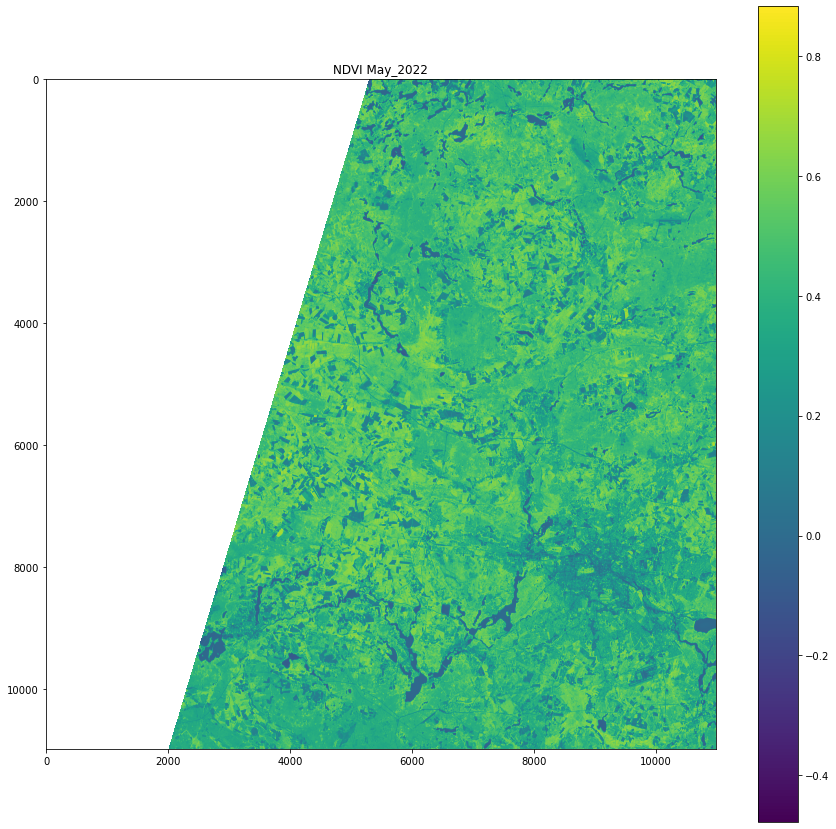

In [13]:
#Read it by using gdal & Visualize it by using matplotlib:
NV_may = gdal.Open("Potsdam_data_map/ndvi_2022.tif")
NV_may = NV_may.ReadAsArray()
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
plt.imshow(NV_may)
plt.title("NDVI May_2022")
plt.colorbar()

In [ ]:
# Create NDVI June_2022 image:
geotiff_ndvi(June_2022_b4, June_2022_b8, "2022")

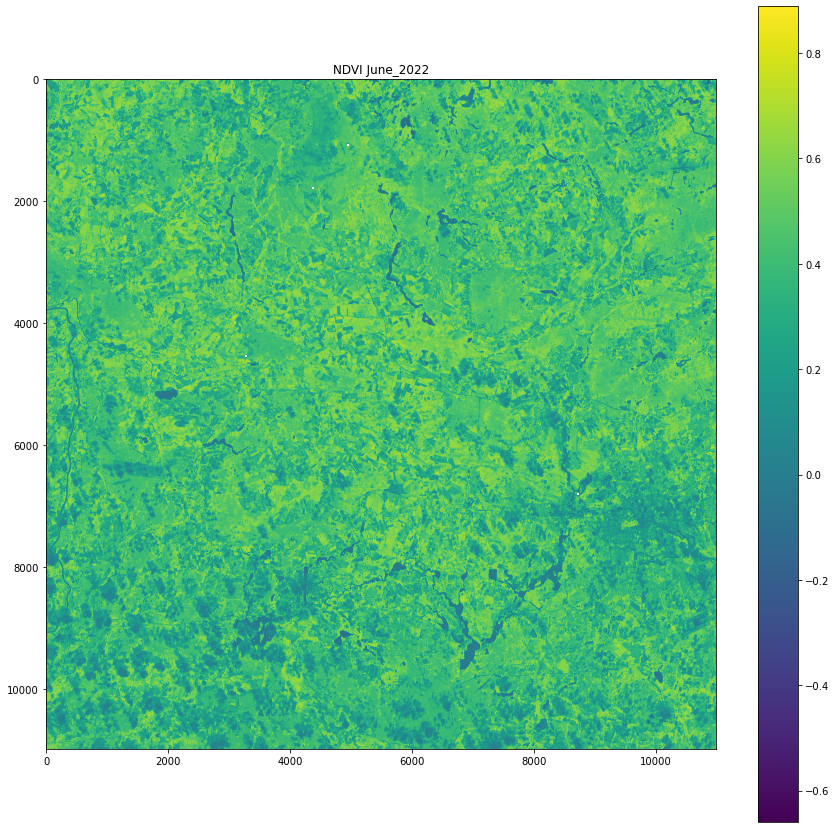

In [14]:
# Visualize it:
NV_june = gdal.Open("June/ndvi_june_2022.tif")
NV_june = NV_june.ReadAsArray()
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
plt.imshow(NV_june)
plt.title("NDVI June_2022")
plt.colorbar()

## Extract Our ROI Map:

* Using the geojson file we created previously, I will extract the region.
* Reproject the data according to the [location.](https://epsg.io/32632).
* Using `rasterio` package to extract our mask and copy it into new map. 

### Creating Mask Area for May_2022

In [ ]:
# reproject:
Potsdam_proj = Potsdam.to_crs({"init" : 'epsg:32632'} )

# transfer the info from whole map into our mask:
with rio.open("ndvi_2022.tif") as src:
    out_image, out_transform = rio.mask.mask(src, Potsdam_proj.geometry,crop=True)
    out_meta = src.meta.copy()
    out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})    
with rasterio.open("NDVI_masked_2022.tif", "w", **out_meta) as dest:
    dest.write(out_image) 

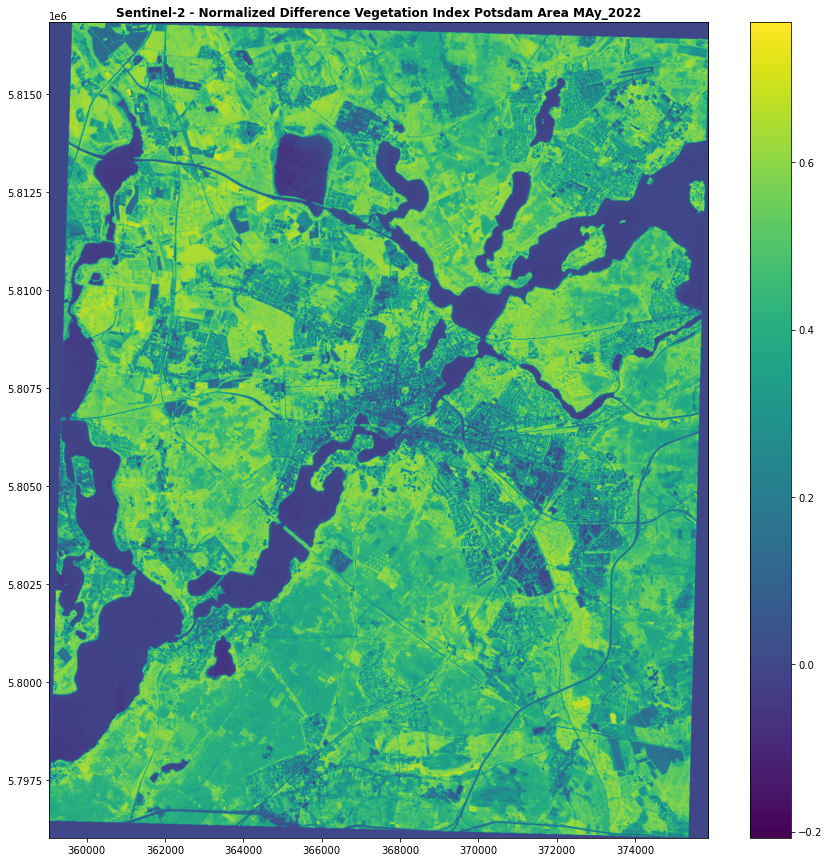

In [40]:
# Visualize the ROI image by using rasterio: 
may_2022_mask = "Potsdam_data_map/NDVI_masked_2022.tif"
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
im = show(rio.open(may_2022_mask), 
     title = ("Sentinel-2 - Normalized Difference Vegetation Index Potsdam Area MAy_2022"),
    ax = ax,)
im = im.get_images()[0]
fig.colorbar(im, ax=ax)

### Creating The Mask Area for June_2022

In [ ]:
# reproject:
Potsdam_proj = Potsdam.to_crs({"init" : 'epsg:32632'} )

# transfer the info from whole map into our mask:
with rio.open("ndvi_june_2022.tif") as src:
    out_image, out_transform = rio.mask.mask(src, Potsdam_proj.geometry,crop=True)
    out_meta = src.meta.copy()
    out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})    
with rasterio.open("NDVI_masked_june_2022.tif", "w", **out_meta) as dest:
    dest.write(out_image) 

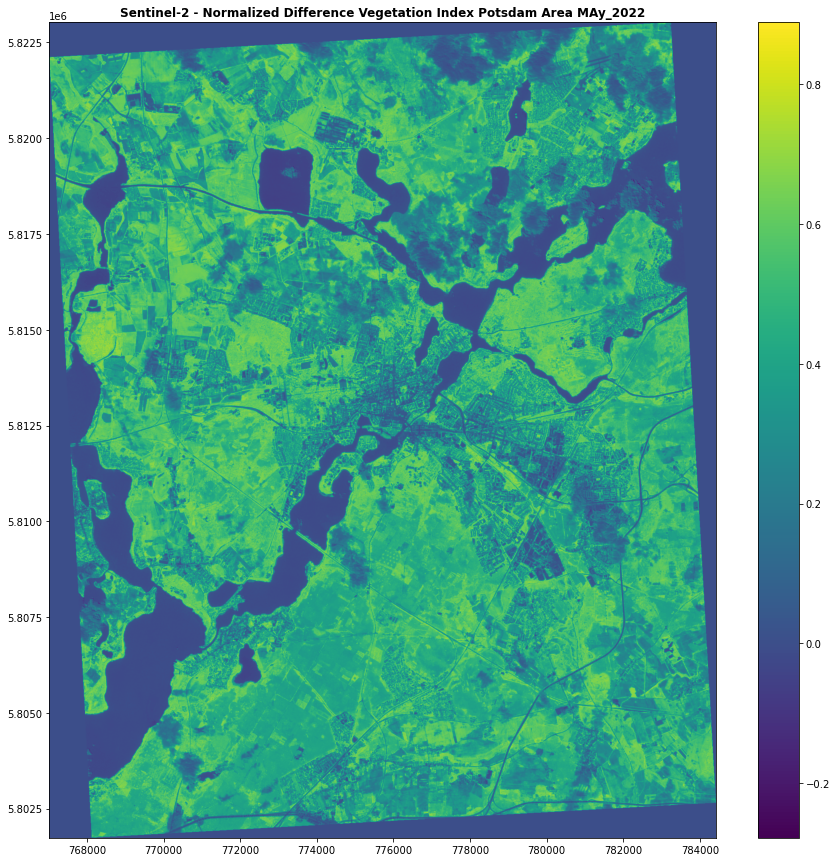

In [41]:
# Visualize the ROI image:
June_2022_mask = "June/NDVI_masked_june_2022.tif"
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
im = show(rio.open(June_2022_mask), 
     title = ("Sentinel-2 - Normalized Difference Vegetation Index Potsdam Area MAy_2022"),
    ax = ax,)
im = im.get_images()[0]
fig.colorbar(im, ax=ax)

## Classify NDVI Values According To Their Classes:

###  Let's create Our function which will:

* By using [Earthpy](https://earthpy.readthedocs.io/en/latest/gallery_vignettes/plot_calculate_classify_ndvi.html#sphx-glr-gallery-vignettes-plot-calculate-classify-ndvi-py) Package
* Creating `classes` depending on our NDVI values. 

Values `under 0` will be classified together as `no vegetation`. Additional classes will be created for bare area and low, moderate, and high vegetation areas.

* Apply the `Nodata mask` to the our classified NDVI data.
* Define our `color` map and `categorical names`.
* Plot Classified NDVI With Categorical Legend - EarthPy by using `Draw_Legend()` function.

In [42]:
def NDVI_Classification(ndvi_map, year):
    # Create classes and apply to NDVI results:
    ndvi_class_bins = [-np.inf, 0, 0.2, np.nanmean(ndvi_map), 0.65, np.inf]
    ndvi_class = np.digitize(ndvi_map, ndvi_class_bins)

    # Apply the nodata mask to the newly classified NDVI data:
    ndvi_class = np.ma.masked_where(
        np.ma.getmask(ndvi_map), ndvi_class
    )


    
    # Define color map:
    nbr_colors = ["gray", "y", "yellowgreen", "g", "darkgreen"]
    nbr_cmap = ListedColormap(nbr_colors)

    # Define class names
    ndvi_cat_names = [
        "No Vegetation",
        "Bare Area",
        "Low Vegetation",
        "Moderate Vegetation",
        "High Vegetation",
    ]

    # Get List of Classes:
    classes = np.unique(ndvi_class)
    classes = classes.tolist()

    # The mask returns a value of none in the classes. remove that:
    classes = classes[:5]


    # Plot The Data:
    fig, ax = plt.subplots(figsize=(12, 12))
    im = ax.imshow(ndvi_class, cmap= nbr_cmap)

    ep.draw_legend(im_ax = im, classes= classes, titles=ndvi_cat_names)
    ax.set_title(
        "Sentinel-2 - Normalized Difference Vegetation Index Classification_" + year,
        fontsize=14,
    )

    # Auto adjust subplot to fit figure size:
    plt.tight_layout()
    
    return classes    

[1, 2, 3, 4, 5]

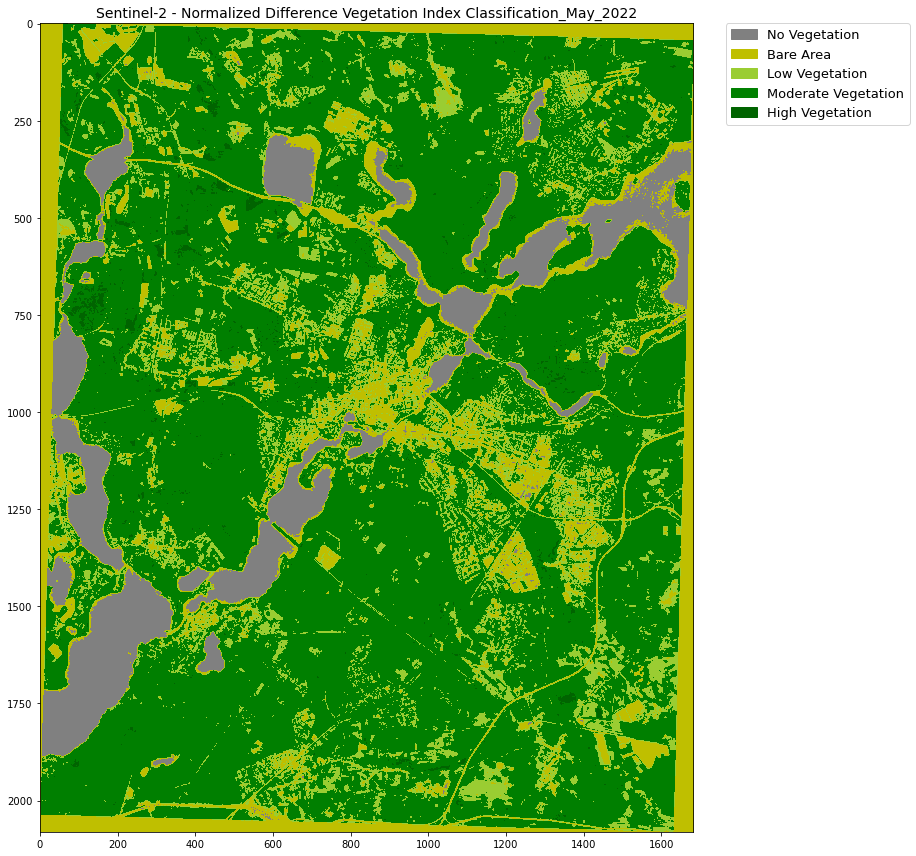

In [45]:
may_2022_mask = gdal.Open("Potsdam_data_map/NDVI_masked_2022.tif")
may_2022_mask = may_2022_mask.ReadAsArray()
NDVI_Classification(may_2022_mask, "May_2022")

[1, 2, 3, 4, 5]

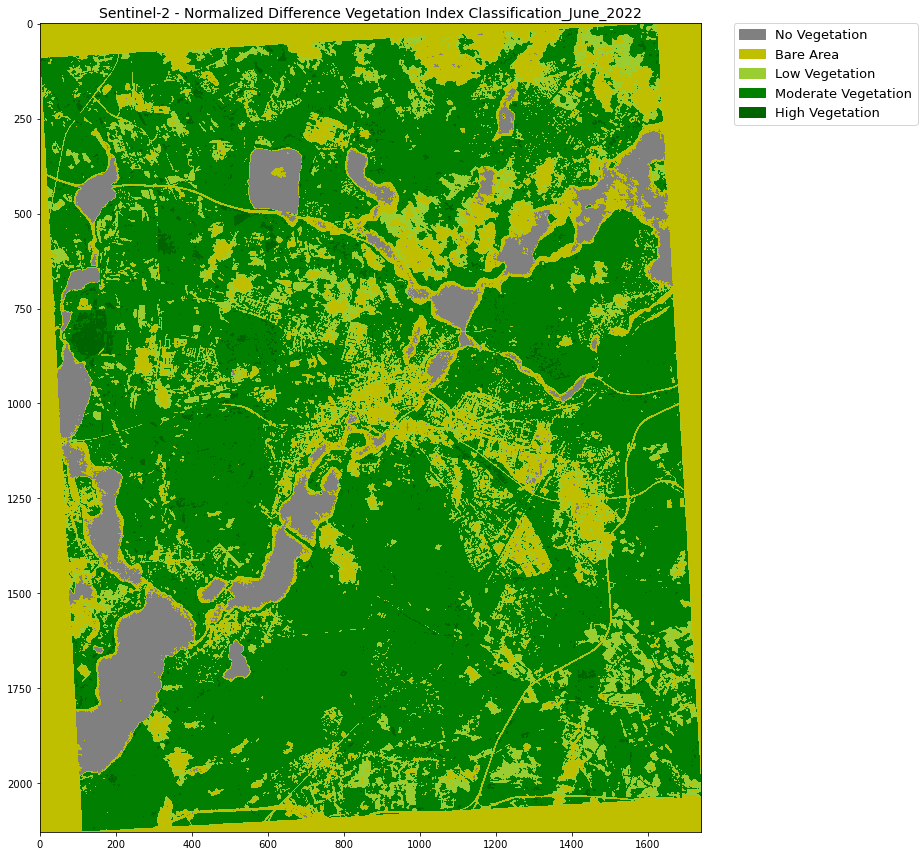

In [46]:
# Craeting mask for NDVI_June_2022:
June_2022_mask = gdal.Open("June/NDVI_masked_june_2022.tif")
June_2022_mask = June_2022_mask.ReadAsArray()
NDVI_Classification(June_2022_mask, "June_2022")

## Filtering Our Classes and Taking The Highest Values:

* We are going to:

    1. Set NDVI values above `0.6` on a new map to identify just the target area
    2. With Scikit-learn, we will add our Mask to the original map as a second class and make the background as one class by using Scikit-learn `Lab to RGB color space conversion` model [label2rgb](https://scikit-image.org/docs/stable/api/skimage.color.html#skimage.color.label2rgb).
    3. We'll then plot a `rectangle` that is equal to or larger than `100` square inches

### NDVI_May_2022

In [58]:
# create a NDVI copy:
ndvi_class_May_22_copy = copy.copy(may_2022_mask)

# create an array only containing NDVI > 0.6
ndvi_class_May_22_copy[may_2022_mask < 0.6] = np.nan
print("MAsk NDVI > 0.6: ", round(np.nanmean(ndvi_class_May_22_copy)))

MAsk NDVI > 0.6:  1


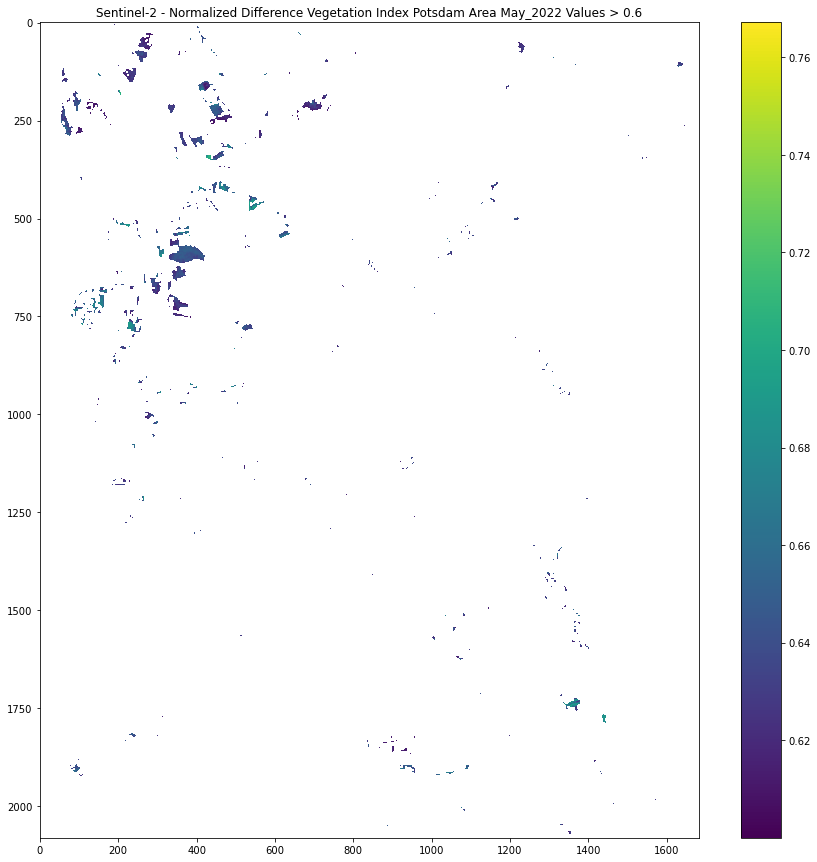

In [60]:
# Let's Visualize our new Mask:
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
plt.imshow(ndvi_class_May_22_copy)
plt.title("Sentinel-2 - Normalized Difference Vegetation Index Potsdam Area May_2022 Values > 0.6")
plt.colorbar()

C:\Users\shadi\anaconda3\envs\gpu\lib\site-packages\skimage\color\colorlabel.py:113: UserWarning: Negative intensities in `image` are not supported
  return _label2rgb_overlay(label, image, colors, alpha, bg_label,
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


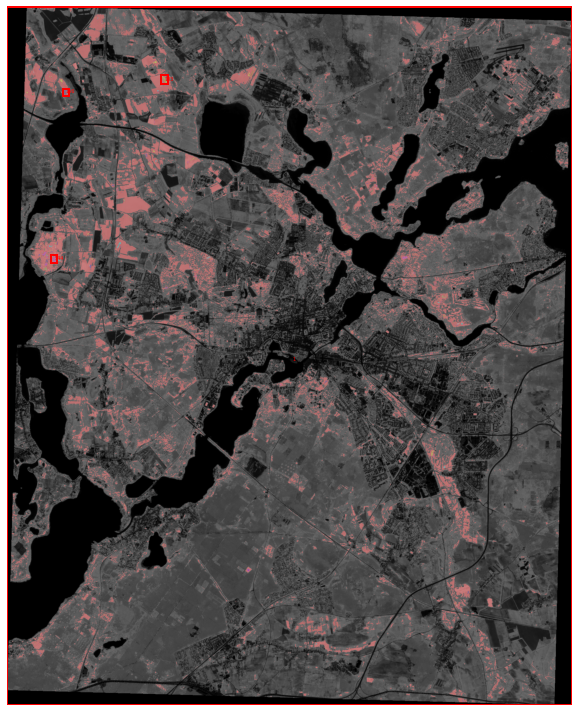

In [61]:
#Let's label image region
label_image = label(ndvi_class_May_22_copy)

# to make the background transparent, pass the value of `bg_label`,
# and leave `bg_color` as `None` and `kind` as `overlay`
image_label_overlay = label2rgb(label_image, image=may_2022_mask, bg_label=1)

# Create a figure and plot the result:
fig, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(image_label_overlay)
# Let's create a rectangle around the area which is more 100 square meters:
for region in regionprops(label_image):
    # take regions with large enough areas
    if region.area >= 100:
        
        # draw rectangle around segmented areas
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=2)
        ax.text(region.centroid[1], region.centroid[0], str(region.label), color='r', fontsize=5)
        ax.add_patch(rect)

ax.set_axis_off()
plt.tight_layout()
plt.show()

### NDVI_June_2022

In [62]:
# create a NDVI copy:
ndvi_class_June_22_copy = copy.copy(June_2022_mask)

# create an array only containing NDVI > 0.6
ndvi_class_June_22_copy[June_2022_mask < 0.6] = np.nan
print("MAsk NDVI > 0.6: ", round(np.nanmean(ndvi_class_June_22_copy)))

MAsk NDVI > 0.6:  1


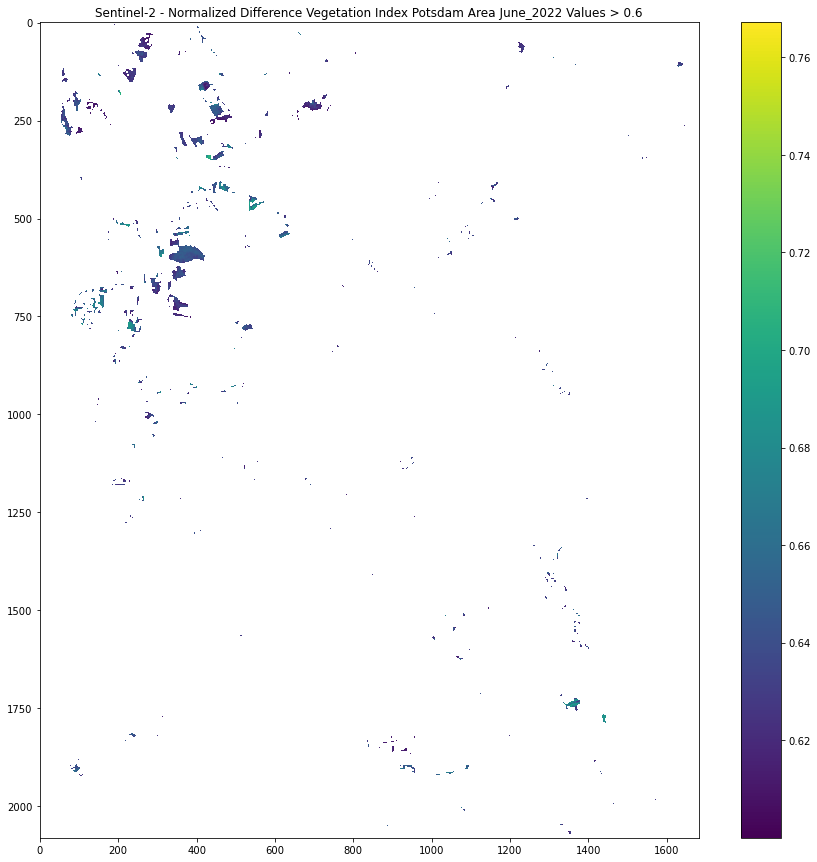

In [63]:
# Let's Visualize our new Mask:
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
plt.imshow(ndvi_class_May_22_copy)
plt.title("Sentinel-2 - Normalized Difference Vegetation Index Potsdam Area June_2022 Values > 0.6")
plt.colorbar()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


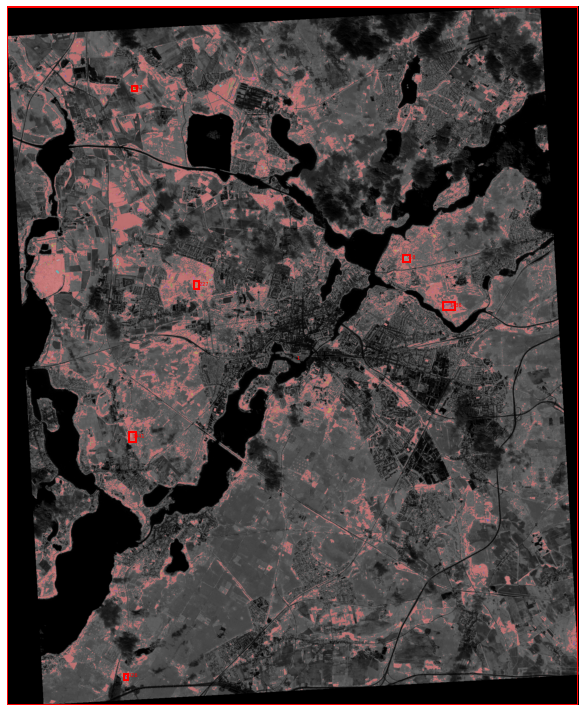

In [64]:
#Let's label image region
label_image = label(ndvi_class_June_22_copy)

# to make the background transparent, pass the value of `bg_label`,
# and leave `bg_color` as `None` and `kind` as `overlay`
image_label_overlay = label2rgb(label_image, image=June_2022_mask, bg_label=1)

# Create a figure and plot the result:
fig, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(image_label_overlay)
# Let's create a rectangle around the area which is more 100 square meters:
for region in regionprops(label_image):
    # take regions with large enough areas
    if region.area >= 100:
        
        # draw rectangle around segmented areas
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=2)
        ax.text(region.centroid[1], region.centroid[0], str(region.label), color='r', fontsize=5)
        ax.add_patch(rect)

ax.set_axis_off()
plt.tight_layout()
plt.show()

## Then for each year from May 2016 to May 2022 and the results

### May Spatio-temporal Map From 2016 To 2022

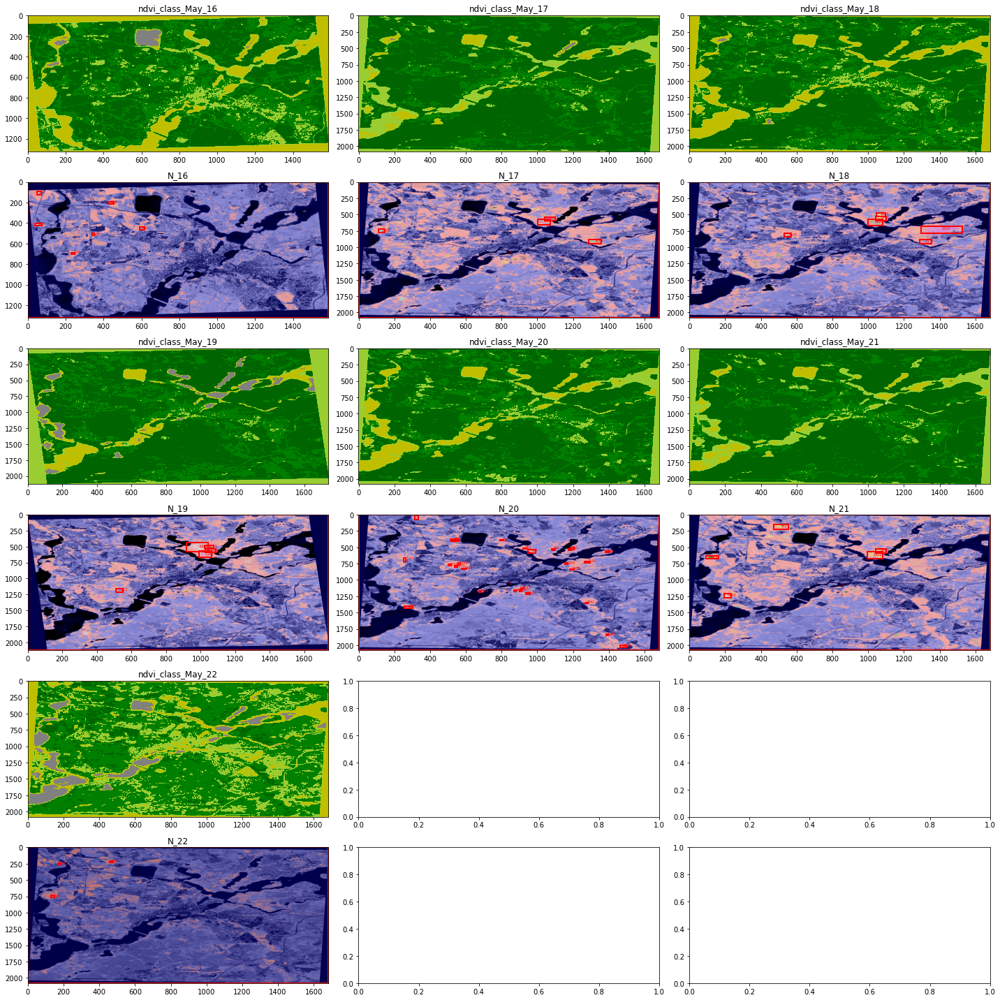

In [65]:
from IPython.display import Image

Image(filename = "Potsdam Spatiotemporal_May.png", width = 1800, height = 1200)

### June Spatio-temporal Map From 2016 To 2022

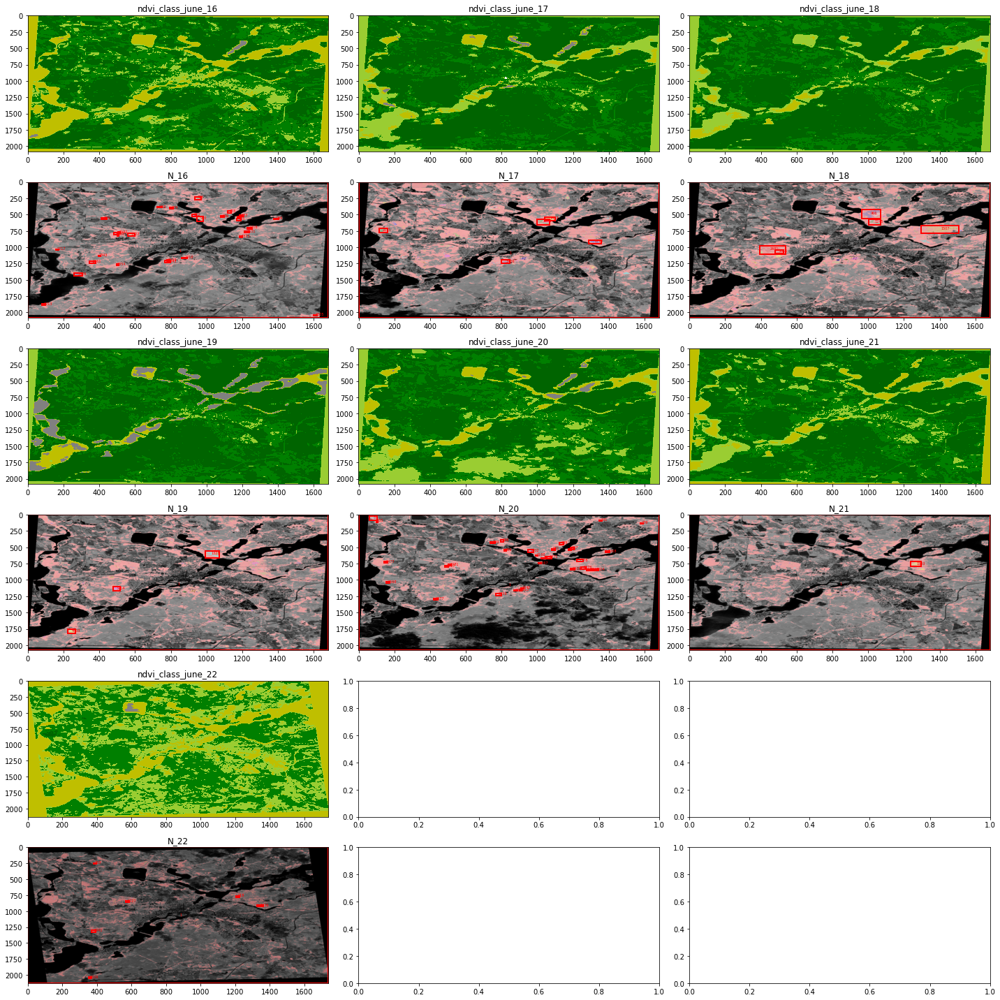

In [66]:
from IPython.display import Image

Image(filename = "June/all.png", width = 1800, height = 1200)

**In both figures, we see that the extent of vegetation index for 2022 is the lowest in comparison with previous years.**

* Let's emphasize this by plotting time series chart by download the data by using [Google Earth Engine.](https://code.earthengine.google.com/)

## Plot Time Series Chart 

Next, We are going to calculate NDVI time series from Sentinel-2 images using the [Google Earth Engine](https://code.earthengine.google.com/) and download it as `CSV`file.

### First:  all the monthes from 2017 to june-2022

In [67]:
# read the data:
Potsdam_ts = pd.read_csv("Postadm_ts.csv")

Potsdam_ts.head(10)

,system:time_start,SCL filter only
0,27-May-17,0.706
1,27-May-17,0.591
2,6-Jun-17,0.656
3,15-Aug-17,0.586
4,4-Sep-17,0.568
5,14-Oct-17,0.009
6,18-Dec-17,0.434
7,14-Jan-18,0.586
8,6-Feb-18,0.522
9,8-Feb-18,0.470


In [68]:
# Change the name of columns
Potsdam_ts.columns =["Date", "NDVI"]
Potsdam_ts.head()

,Date,NDVI
0,27-May-17,0.706
1,27-May-17,0.591
2,6-Jun-17,0.656
3,15-Aug-17,0.586
4,4-Sep-17,0.568


In [69]:
#ploting it by Using plotly.express
df = px.data.stocks()
fig = px.line(Potsdam_ts,
              x='Date', 
              y="NDVI",
             title = "NDVI Potsdam <br><sup>All The Values</sup>")
fig.show()

### Extract the values Just for May & June

In [70]:
# Read the files:
Potsdam_May_June_ts = pd.read_csv("May_June_Potsdam_ts.csv")
# Change the name of columns
Potsdam_May_June_ts.columns =["Date", "NDVI"]
Potsdam_May_June_ts.head()

,Date,NDVI
0,2017-05-27,0.591
1,2017-06-06,0.656
2,2018-05-04,0.637
3,2018-05-07,0.605
4,2018-05-09,0.594


In [73]:
# Let's Extract every year as indevidual reading:
Potsdam_2017 = Potsdam_May_June_ts[:2]
Potsdam_2018 = Potsdam_May_June_ts[2:11]
Potsdam_2019 = Potsdam_May_June_ts[11:21]
Potsdam_2020 = Potsdam_May_June_ts[21:32]
Potsdam_2021 = Potsdam_May_June_ts[32:40]
Potsdam_2022 = Potsdam_May_June_ts[40:]

In [78]:
import plotly.graph_objects as go

# Create traces
fig = go.Figure(layout=layout)
fig.add_trace(go.Scatter(x=Potsdam_2017["Date"], y=Potsdam_2017["NDVI"],
                    mode='lines+markers',
                    name='Potsdam_2017'))

fig.add_trace(go.Scatter(x=Potsdam_2018["Date"], y=Potsdam_2018["NDVI"],
                    mode='lines+markers',
                    name='Potsdam_2018'))

fig.add_trace(go.Scatter(x=Potsdam_2019["Date"], y=Potsdam_2019["NDVI"],
                    mode='lines+markers', name='Potsdam_2019'))

fig.add_trace(go.Scatter(x=Potsdam_2020["Date"], y=Potsdam_2020["NDVI"],
                    mode='lines+markers', name='Potsdam_2020'))

fig.add_trace(go.Scatter(x=Potsdam_2021["Date"], y=Potsdam_2021["NDVI"],
                    mode='lines+markers', name='Potsdam_2021'))

fig.add_trace(go.Scatter(x=Potsdam_2022["Date"], y=Potsdam_2022["NDVI"],
                    mode='lines+markers', name='Potsdam_2022'))
layout = go.Layout(
    title = "NDVI Potsdam <br><sup>May & June</sup>"

)

fig.show()
# Save the figure as HTML figure:
# fig.write_html("time_series.html")

## Take a look on the `higher resolution` map by using QGIS Tool:

* I am going to download some of the high-resolution google satellite images with georeferencing by using [tilr_plus](http://www.mediafire.com/file/ttqn954oi3b1nsu/tile_plus.zip/file) tool in [QGIS](https://qgis.org/en/site/index.html)

* We will use this as a reference to determine if there is high air quality in this area in our next step of the study.

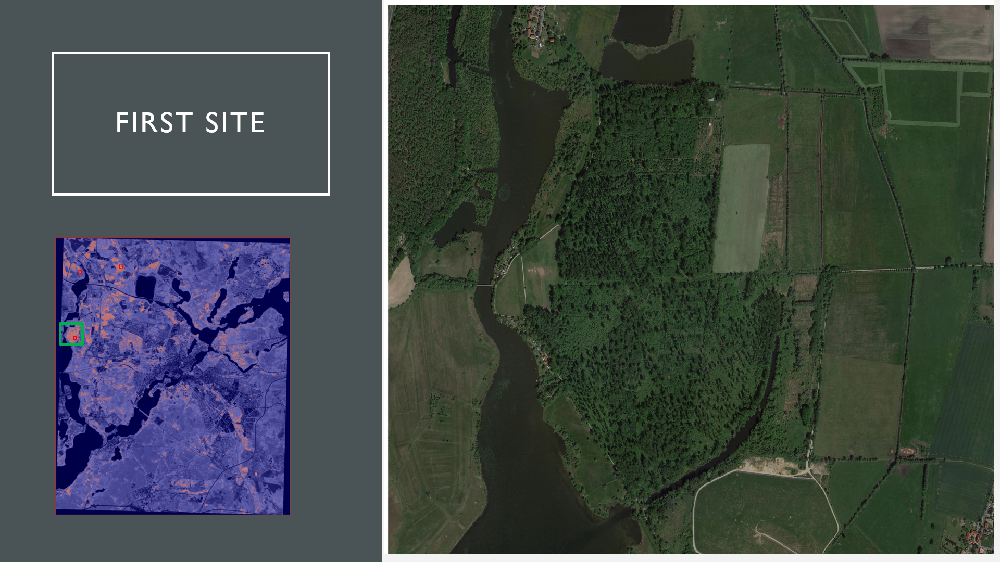

In [1]:
from IPython.display import Image

Image(filename = "First_site.png")

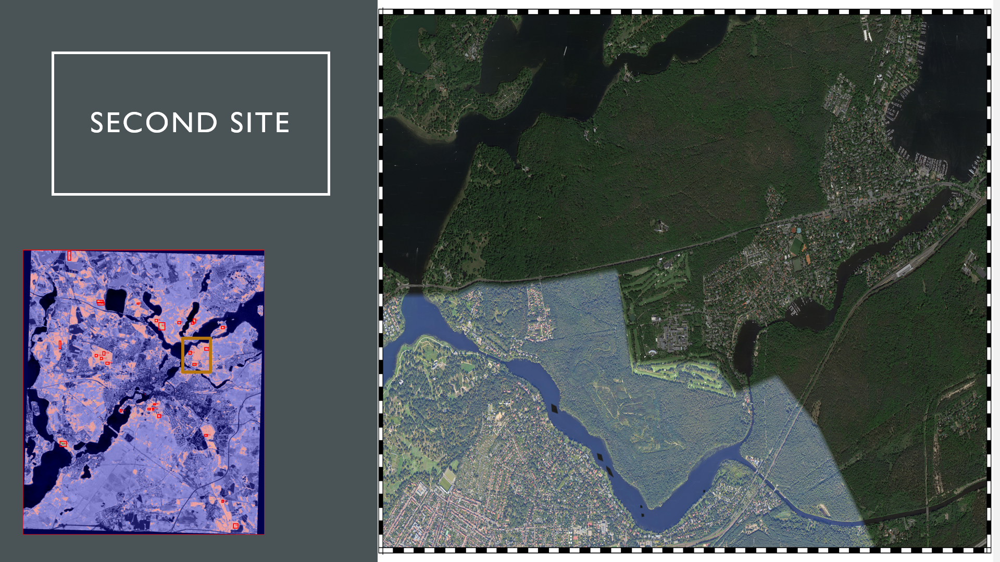

In [2]:
Image(filename = "Second_site.png")

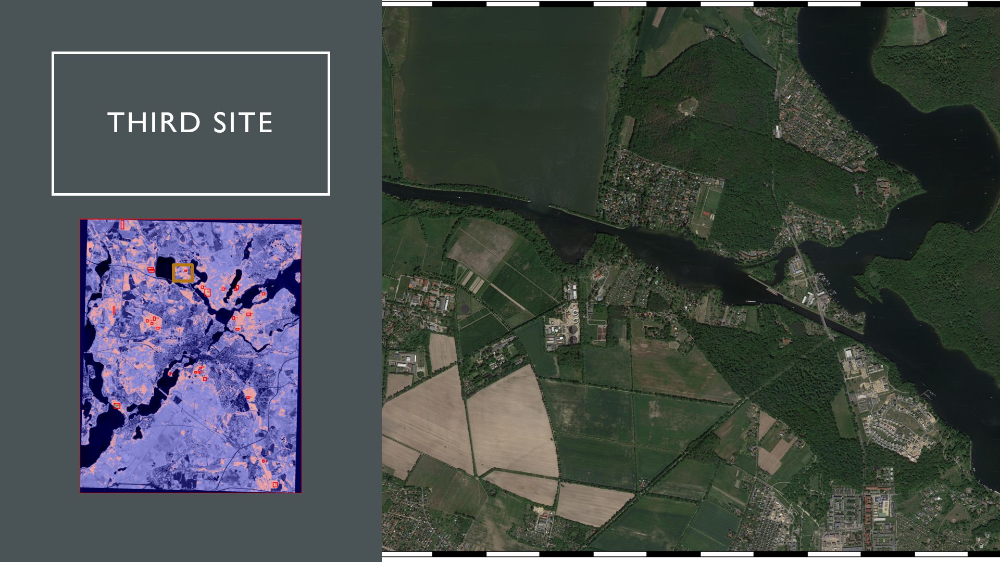

In [3]:
Image(filename = "Third_site.png")

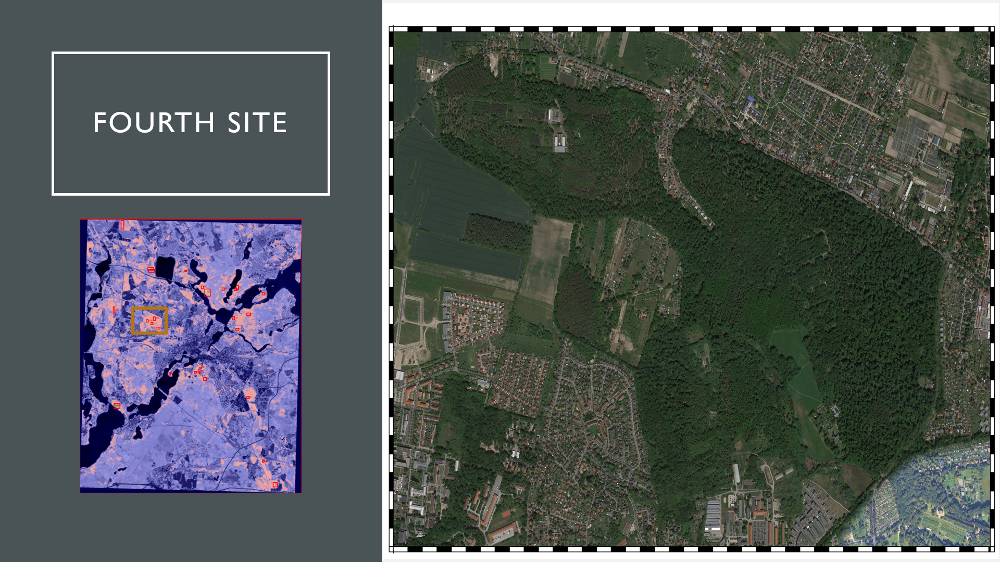

In [4]:
Image(filename = "Fourth_site.png")

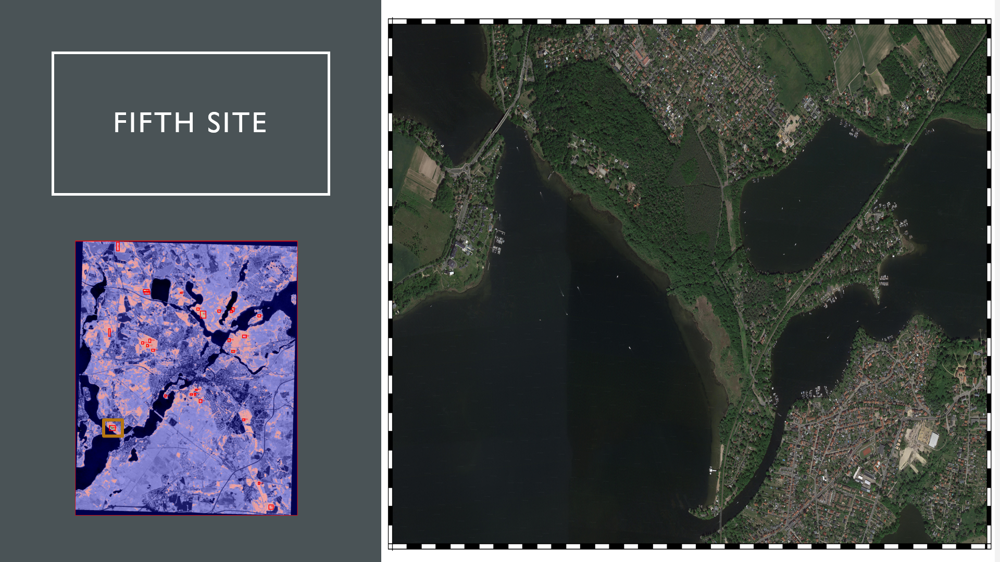

In [5]:
Image(filename = "Fifth_site.png")